## Model the Credit Risk & Evaluate model performance
We are working with a fairly small dataset at 1,000 rows. This means that there is a significant risk that when we split it into train and test sets only once, we might be "lucky" and end up with all the "easy" samples in the test set by pure chance. This would lead to better than expected results on the test set and a seemingly better model than we think we have. Conversely, the opposite can happen as well.

A safer approach is to split the data many times in different ways and average the results. This way we are less likely to over-estimate the model performance by pure chance. This is referred to as cross-validation. We will use 10-fold cross-validation as it is frequently used and normally works well. Since the dataset is small, it shouldn't take too long to run either.

It's common to experiment a lot during model development. But in order to speed things up, we will do a light version of it. Thus, we will evaluate three different models; Logistic Regression, Random Forest and LightGBM. Additionally, we will also do basic parameter tuning to optimize the models, while making sure to use nested cross-validation to not bias the results.

For `Logistic Regression`, we need to scale the data for the model to properly learn. If a feature is significantly larger than the others (such as `credit_amount` vs `checking_status`), the model might over-estimate the importance of that feature, often leading to worse results. We can use `StandardScaler` to center the data round 0. Tree-based models such as Random Forest and LightGBM don't need this.

A `Pipeline` will make sure that these steps are conducted properly by preventing data leakage.

We will use `AUC` as the main evaluation metric to tune and compare the trained models. It's a comparably complete metric that takes into account both True Positive and False Positive rates. Additionally, we will measure specificity, recall and accuracy to get a more holistic picture of the model performance.

### Logistic Regression
Start by training and evaluating a Logistic regression model. We will tune the regularisation strength `C`. *Lower values mean more regularization*, which normally helps the model to better generalise to unseen data. We can use Scikit-Optimize's `BayesSearchCV` for this, which smoothly integrates with scikit-learn models.

In [42]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.patheffects as path_effects
import seaborn as sns

import time
import joblib

from sklearn.feature_selection import SelectKBest, chi2
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import RobustScaler, OrdinalEncoder, OneHotEncoder, StandardScaler
from sklearn.model_selection import GridSearchCV, StratifiedKFold, train_test_split, cross_validate, cross_val_predict
from sklearn.svm import SVC

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier

from sklearn.metrics import ConfusionMatrixDisplay, classification_report, make_scorer, RocCurveDisplay, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report

from imblearn.metrics import specificity_score

from skopt import BayesSearchCV
from skopt.space import Real, Categorical, Integer

# Make sure that we can see all columns in the ouputs
pd.set_option('display.max_columns', 65)

In [2]:
credit_dev = pd.read_csv('../datasets/cleaned/train/credit_train.csv')

In [3]:
# Reorder columns so the target variable is at the first position
cols = list(credit_dev.columns)
cols.remove('class')
cols.insert(0, 'class')
credit_dev = credit_dev[cols]

# Randomly shuffle the data to minimise the effect of randomness on our results
credit_enc = credit_dev.sample(frac=1.0, random_state=55)

In [4]:
# Select numerical variables
numerical = ['duration', 'credit_amount', 'age']
categorical = [col for col in credit_dev.columns if col not in numerical]

In [7]:
# Select all categorical columns
# categorical = credit_enc.select_dtypes(include=['object']).columns
categorical_columns = [c for c in credit_enc.columns if c not in numerical]

# Define encoder. As we are dealing with categorical variables, make sure that the output are integers
oe = OrdinalEncoder(dtype=np.int64)

# Transform the categorical columns
credit_enc[categorical] = oe.fit_transform(credit_enc[categorical])

# Verify that it looks as expected
credit_enc.head()

,class,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,...,residence_since,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker
214,0,1,45,4,0,11816,2,3,1,3,...,3,0,29,1,2,1,1,0,0,1
596,1,1,6,3,6,2647,1,0,1,3,...,2,3,44,1,2,0,1,1,0,1
266,0,0,36,3,4,12389,4,0,0,3,...,3,2,37,1,0,0,1,0,1,1
448,1,3,9,1,3,2406,2,4,1,3,...,2,0,31,1,1,0,0,0,0,1
528,1,1,24,3,6,1603,2,3,3,0,...,3,0,55,1,1,0,1,0,0,1


In [8]:
# Select features and target variable
X = credit_enc[credit_enc.columns.difference(['class'])]
Y = credit_enc['class']

In [9]:
# Select the top 10 most important features using chi-squared
selector = SelectKBest(chi2, k=10).fit(X, Y)
X = pd.DataFrame(selector.transform(X), 
                 columns=selector.get_feature_names_out()) 

# Display the resulting feature set
X.head()

,age,checking_status,credit_amount,credit_history,duration,existing_credits,personal_status,property_magnitude,purpose,savings_status
0,29,1,11816,4,45,1,3,0,0,2
1,44,1,2647,3,6,0,3,3,6,1
2,37,0,12389,3,36,0,3,2,4,4
3,31,3,2406,1,9,0,3,0,3,2
4,55,1,1603,3,24,0,0,0,6,2


In [10]:
# Split into train and test sets. 
trainX, testX, trainY, testY = train_test_split(X, Y, test_size=0.2, random_state=89, stratify=Y)
trainX.head()

,age,checking_status,credit_amount,credit_history,duration,existing_credits,personal_status,property_magnitude,purpose,savings_status
30,23,0,836,3,12,0,0,1,4,0
263,41,0,3979,3,48,1,3,0,6,4
533,49,0,8386,1,30,0,3,1,3,2
161,42,0,5084,3,24,0,0,0,6,4
618,42,3,1544,1,4,2,3,3,6,2


### Logistic Regression

In [13]:
%%time

# Specify model and subsequent hyperparameters to tune
lr = LogisticRegression(max_iter=1000)
parameters = {
        'clf__C': Real(1e-3, 1e+2, prior='log-uniform'),
}

# Create final pipeline
pipeline = Pipeline(steps=([('scaler', StandardScaler()),
                            ('clf', lr)]))

# Specify scoring metrics
scoring = {
        "auc"        : "roc_auc",
        "specificity": make_scorer(specificity_score, average="weighted"),
        "recall"     : "recall",
        "accuracy"   : "accuracy",
}

# Perform hyperparameter tuning with BayesSearchCV over 10 folds with AUC as refit metric.
gs_lr = BayesSearchCV(pipeline, parameters, cv=10, scoring=scoring, 
                      refit="auc", random_state=500, n_iter=10)

# We need to fit the BayesSearchCV object to the train data in order to make predictions with the best model later
gs_lr.fit(trainX, trainY)

# Run nested cross-validation over 10 folds
lr_scores = cross_validate(gs_lr, X, Y, cv=10, n_jobs=-1, verbose=1,
                        return_train_score=True, scoring=scoring)

# Make cross-validated predictions 
lr_preds = cross_val_predict(pipeline, X, Y, cv=10, n_jobs=-1)

time.sleep(1)
for score in lr_scores:
        print(f"{score:<17}: {np.mean(lr_scores[score]):.2f}")

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:    0.9s remaining:    3.7s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    1.0s finished


fit_time         : 0.81
score_time       : 0.00
test_auc         : 0.74
train_auc        : 0.75
test_specificity : 0.42
train_specificity: 0.43
test_recall      : 0.95
train_recall     : 0.95
test_accuracy    : 0.72
train_accuracy   : 0.73
CPU times: user 1.64 s, sys: 2.93 s, total: 4.56 s
Wall time: 2.85 s


In [16]:
# Save best LR model pipeline
best_lr_model = gs_lr.best_estimator_
print(f"Best model:\n{gs_lr.best_estimator_}")
joblib.dump(best_lr_model, '../models/lr_model_pipeline.pkl')

Best model:
Pipeline(steps=[('scaler', StandardScaler()),
                ('clf',
                 LogisticRegression(C=0.030956075088984472, max_iter=1000))])


['../models/lr_model_pipeline.pkl']

In [17]:
%%bash

model="lr_model_pipeline.pkl"
sizeKB=$(du -k "../models/$model" | cut -f 1)
echo Size for $model is $sizeKB kb

Size for lr_model_pipeline.pkl is 4 kb


We can take a closer look at the model performance by creating a `confusion matrix`, plotting the ROC AUC curve and display some metrics with sklearn's `classification_report` as follows. Display one normalised and one confusion matrix with real values.

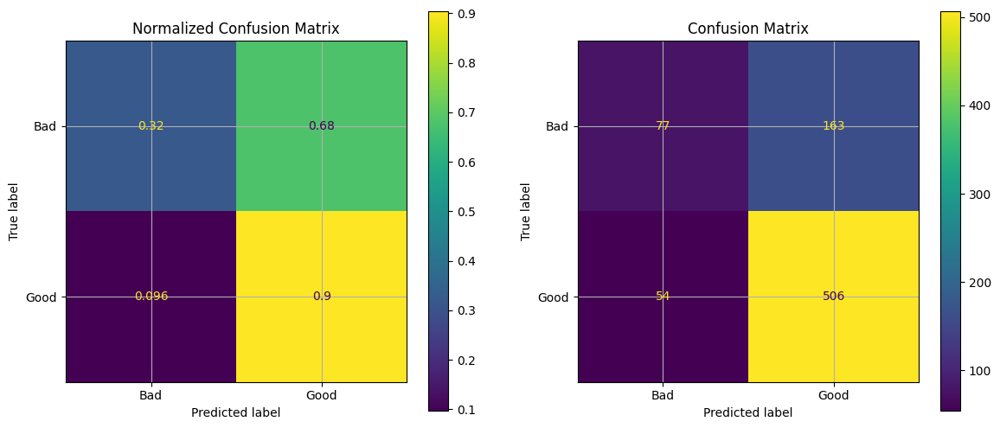

In [21]:
# Confusion matrix for the Logistic regression model
f, axs = plt.subplots(1, 2, figsize=(14, 6))  # Change the subplot layout

ConfusionMatrixDisplay.from_predictions(Y, lr_preds,
                                        display_labels=['Bad', 'Good'],
                                        normalize="true",
                                        ax=axs[0])
axs[0].grid()
axs[0].set_title('Normalized Confusion Matrix')  # Add title

ConfusionMatrixDisplay.from_predictions(Y, lr_preds,
                                        display_labels=['Bad', 'Good'],
                                        normalize=None,
                                        ax=axs[1])
axs[1].grid()
axs[1].set_title('Confusion Matrix')  # Add title

plt.show()


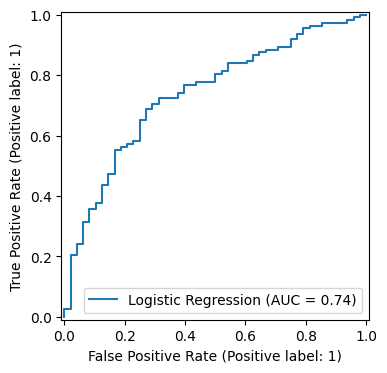

In [22]:
# Plot ROC AUC curve on the test set
f, axs = plt.subplots(1, 1, figsize=(5, 4))
RocCurveDisplay.from_estimator(gs_lr.best_estimator_, testX, testY, 
                               name="Logistic Regression",
                               ax=axs);

In [23]:
# Classification report for Logistic Regression
print(classification_report(Y, lr_preds, target_names=['Bad', 'Good']))

              precision    recall  f1-score   support

         Bad       0.59      0.32      0.42       240
        Good       0.76      0.90      0.82       560

    accuracy                           0.73       800
   macro avg       0.67      0.61      0.62       800
weighted avg       0.71      0.73      0.70       800



AUC on the test set is 70% while 74% when cross validated. We note that the model predicts the sample as `good` (1) in most cases, including when it shouldn't (which results in many false positives). We also note that both precision, recall (equivalent to the diagonal) and the f1-score are pretty low for the `bad` (0) class.

### Random Forest

Train and evaluate a Random Forest model.

We can exclude the pipeline since we don't need to scale the data. The `n_estimators` parameter specify how many individual trees the model compose of. More trees normally mean that it can better learn the data. We will tune this hyperparameter together with `max_depth`, which specifies how deep each tree can grow (deeper trees can split the data more fine-grained, but there is a larger risk of overfitting

In [25]:
%%time

# Specify model and subsequent hyperparameters to tune
rf = RandomForestClassifier(random_state=99)
parameters = {'n_estimators': Integer(10, 200, prior='uniform'),
              'max_depth': Integer(2, 8, prior='uniform'),
              'min_samples_split': Integer(2, 5, prior='uniform'),
}

# Perform hyperparameter tuning with BayesSearchCV over 10 folds with AUC as refit metric.
gs_rf = BayesSearchCV(rf, parameters, cv=10, scoring=scoring, 
                      refit="auc", random_state=500, n_iter=10)

# Fit the BayesSearchCV object to the train data
gs_rf.fit(trainX, trainY)

# Run nested cross-validation over 10 folds
rf_scores = cross_validate(gs_rf, X, Y, cv=10, n_jobs=-1, verbose=1,
                           return_train_score=True, scoring=scoring)

# Make cross-validated predictions 
rf_preds = cross_val_predict(gs_rf, X, Y, cv=10, n_jobs=-1, verbose=3)

time.sleep(1)
for score in rf_scores:
        print(f"{score:<17}: {np.mean(rf_scores[score]):.2f}")

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:   15.2s remaining:  1.0min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   15.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  10 | elapsed:    9.6s remaining:   22.4s
[Parallel(n_jobs=-1)]: Done   7 out of  10 | elapsed:    9.8s remaining:    4.2s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    9.9s finished


fit_time         : 9.21
score_time       : 0.01
test_auc         : 0.78
train_auc        : 0.95
test_specificity : 0.54
train_specificity: 0.74
test_recall      : 0.92
train_recall     : 0.98
test_accuracy    : 0.76
train_accuracy   : 0.88
CPU times: user 7.66 s, sys: 3.81 s, total: 11.5 s
Wall time: 34 s


In [26]:
# Save best RF model
best_rf_model = gs_rf.best_estimator_
print(f"Best model: {gs_rf.best_estimator_}")
joblib.dump(best_rf_model, '../models/rf_model_pipeline.pkl')

Best model: RandomForestClassifier(max_depth=8, min_samples_split=4, n_estimators=127,
                       random_state=99)


['../models/rf_model_pipeline.pkl']

In [27]:
%%bash

model="rf_model_pipeline.pkl"
sizeKB=$(du -k "../models/$model" | cut -f 1)
echo Size for $model is $sizeKB kb

Size for rf_model_pipeline.pkl is 1172 kb


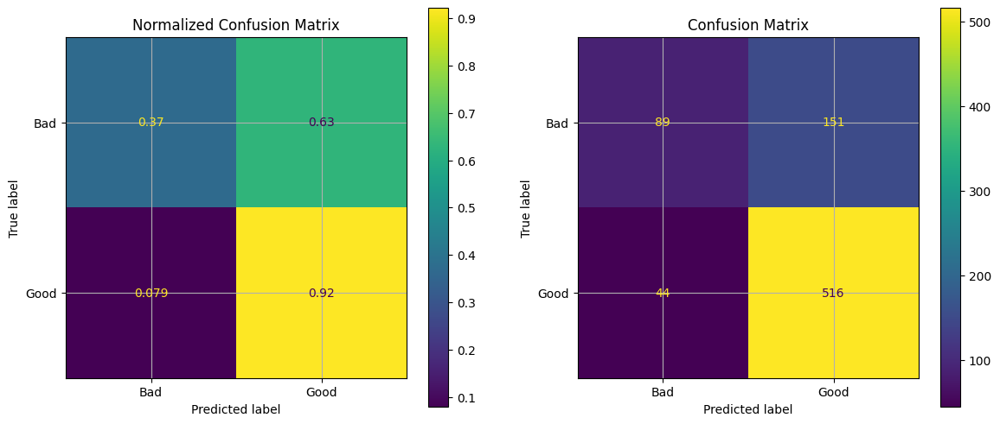

In [29]:
# Confusion matrix for the Logistic regression model
f, axs = plt.subplots(1, 2, figsize=(14, 6))  # Change the subplot layout

ConfusionMatrixDisplay.from_predictions(Y, rf_preds,
                                        display_labels=['Bad', 'Good'],
                                        normalize="true",
                                        ax=axs[0])
axs[0].grid()
axs[0].set_title('Normalized Confusion Matrix')  # Add title

ConfusionMatrixDisplay.from_predictions(Y, rf_preds,
                                        display_labels=['Bad', 'Good'],
                                        normalize=None,
                                        ax=axs[1])
axs[1].grid()
axs[1].set_title('Confusion Matrix')  # Add title

plt.show()

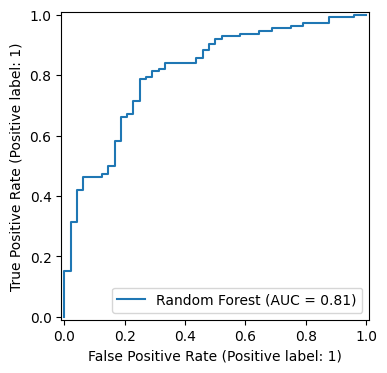

In [30]:
# Plot ROC AUC curve on the test set
f, axs = plt.subplots(1, 1, figsize=(5, 4))
RocCurveDisplay.from_estimator(gs_rf.best_estimator_, testX, testY, 
                               name="Random Forest",
                               ax=axs);

In [31]:
# Classification report for Random Forest
print(classification_report(Y, rf_preds, target_names=['Bad', 'Good']))

              precision    recall  f1-score   support

         Bad       0.67      0.37      0.48       240
        Good       0.77      0.92      0.84       560

    accuracy                           0.76       800
   macro avg       0.72      0.65      0.66       800
weighted avg       0.74      0.76      0.73       800



AUC on the test set is 81% while its cross-validated AUC is 78%. Random Forest also seem to predict the sample as good (1) in most cases, including when it shouldn't (which results in many false positives). Although perhaps more equally distributed than for Logistic regression, precision, recall (equivalent to the diagonal) and the f1-score are very low for the bad (0) class here as well.

Additionally, we note that Random Forest takes close to 10 times longer to train than Logistic Regression.

### LightGBM

In [34]:
%%time

# Specify model and subsequent hyperparameters to tune. There are many more parameters to choose from
lgbm = LGBMClassifier(random_state=99)
parameters = {'n_estimators': Integer(10, 200, prior='uniform'),
              'max_depth': Integer(2, 8, prior='uniform'),
              'num_leaves': Integer(20, 60, prior='uniform'),
}

# Perform hyperparameter tuning with BayesSearchCV over 10 folds with AUC as refit metric.
# LightGBM is faster than RF so we can try more combinations (20 instead of 10)
gs_lgbm = BayesSearchCV(lgbm, parameters, cv=10, scoring=scoring, 
                       refit="auc", random_state=500, n_iter=20)

# Fit the BayesSearchCV object to the train data
gs_lgbm.fit(trainX, trainY)

# Run nested cross-validation over 10 folds
lgbm_scores = cross_validate(gs_lgbm, X, Y, cv=10, n_jobs=-1, verbose=1,
                           return_train_score=True, scoring=scoring)

# Make cross-validated predictions 
lgbm_preds = cross_val_predict(gs_lgbm, X, Y, cv=10, n_jobs=-1, verbose=3)

time.sleep(1)
for score in lgbm_scores:
        print(f"{score:<17}: {np.mean(lgbm_scores[score]):.2f}")

[LightGBM] [Info] Number of positive: 404, number of negative: 172
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 298
[LightGBM] [Info] Number of data points in the train set: 576, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.701389 -> initscore=0.853920
[LightGBM] [Info] Start training from score 0.853920
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.


[LightGBM] [Info] Number of positive: 454, number of negative: 194
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 325
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.700617 -> initscore=0.850239
[LightGBM] [Info] Start training from score 0.850239
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:   16.6s remaining:  1.1min


[LightGBM] [Info] Number of positive: 454, number of negative: 194
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000488 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 324
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.700617 -> initscore=0.850239
[LightGBM] [Info] Start training from score 0.850239
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   19.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.


sitive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[Parallel(n_jobs=-1)]: Done   3 out of  10 | elapsed:   13.0s remaining:   30.3s


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[Parallel(n_jobs=-1)]: Done   7 out of  10 | elapsed:   13.3s remaining:    5.7s


[LightGBM] [Info] Number of positive: 504, number of negative: 216
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 350
[LightGBM] [Info] Number of data points in the train set: 720, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.700000 -> initscore=0.847298
[LightGBM] [Info] Start training from score 0.847298
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   14.5s finished


fit_time         : 17.03
score_time       : 0.00
test_auc         : 0.77
train_auc        : 0.93
test_specificity : 0.55
train_specificity: 0.76
test_recall      : 0.89
train_recall     : 0.95
test_accuracy    : 0.74
train_accuracy   : 0.87
CPU times: user 28.4 s, sys: 1min 7s, total: 1min 36s
Wall time: 46.5 s


In [35]:
# Save best LightGBM model
best_lgbm_model = gs_lgbm.best_estimator_
print(f"Best model: {gs_lgbm.best_estimator_}")
joblib.dump(best_lgbm_model, '../models/lgbm_model_pipeline.pkl')

Best model: LGBMClassifier(max_depth=2, n_estimators=86, num_leaves=60, random_state=99)


['../models/lgbm_model_pipeline.pkl']

In [36]:
%%bash

model="lgbm_model_pipeline.pkl"
sizeKB=$(du -k "../models/$model" | cut -f 1)
echo Size for $model is $sizeKB kb

Size for lgbm_model_pipeline.pkl is 52 kb


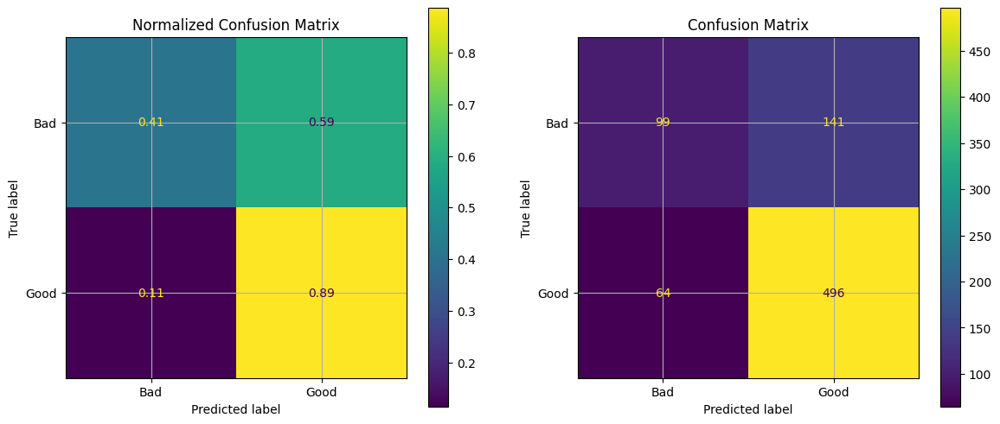

In [37]:
# Confusion matrix for the Logistic regression model
f, axs = plt.subplots(1, 2, figsize=(14, 6))  # Change the subplot layout

ConfusionMatrixDisplay.from_predictions(Y, lgbm_preds,
                                        display_labels=['Bad', 'Good'],
                                        normalize="true",
                                        ax=axs[0])
axs[0].grid()
axs[0].set_title('Normalized Confusion Matrix')  # Add title

ConfusionMatrixDisplay.from_predictions(Y, lgbm_preds,
                                        display_labels=['Bad', 'Good'],
                                        normalize=None,
                                        ax=axs[1])
axs[1].grid()
axs[1].set_title('Confusion Matrix')  # Add title

plt.show()

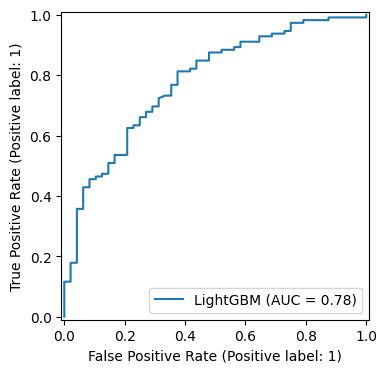

In [38]:
# Plot ROC AUC curve on the test set
f, axs = plt.subplots(1, 1, figsize=(5, 4))
RocCurveDisplay.from_estimator(gs_lgbm.best_estimator_, testX, testY, 
                               name="LightGBM",
                               ax=axs);

In [39]:
# Classification report for LightGBM
print(classification_report(Y, lgbm_preds, target_names=['Bad', 'Good']))

              precision    recall  f1-score   support

         Bad       0.61      0.41      0.49       240
        Good       0.78      0.89      0.83       560

    accuracy                           0.74       800
   macro avg       0.69      0.65      0.66       800
weighted avg       0.73      0.74      0.73       800



LightGBM achieves an AUC of 80% on the test set while its cross-validated AUC is 77%.

### XGB Classifier

In [ ]:
### 

### Summary
Visually display how the Logistic Regression, Random Forest and the LightGBM models perform.

Note that the following AUC scores differ from the AUC plots above because they're the median over all 10 cv-folds. This is a more reliable estimate of the models' performance due to the small dataset.

In [43]:
def get_results(df, score):
    """ Function for extracting train and test scores. """
    score = score.lower()
    return pd.DataFrame({f'train_{score}': df[f'train_{score}'],
                         f'test_{score}': df[f'test_{score}']})


def add_median_labels(ax, fmt='.2f'):
    """ Function for plotting the median on a boxplot.
        https://stackoverflow.com/questions/38649501/labeling-boxplot-in-seaborn-with-median-value
    """
    lines = ax.get_lines()
    boxes = [c for c in ax.get_children() if type(c).__name__ == 'PathPatch']
    lines_per_box = int(len(lines) / len(boxes))
    for median in lines[4:len(lines):lines_per_box]:
        x, y = (data.mean() for data in median.get_data())
        # choose value depending on horizontal or vertical plot orientation
        value = x if (median.get_xdata()[1] - median.get_xdata()[0]) == 0 else y
        text = ax.text(x, y, f'{value:{fmt}}', ha='center', va='center',
                       fontweight='bold', color='white')
        # create median-colored border around white text for contrast
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground=median.get_color()),
            path_effects.Normal(),
        ])

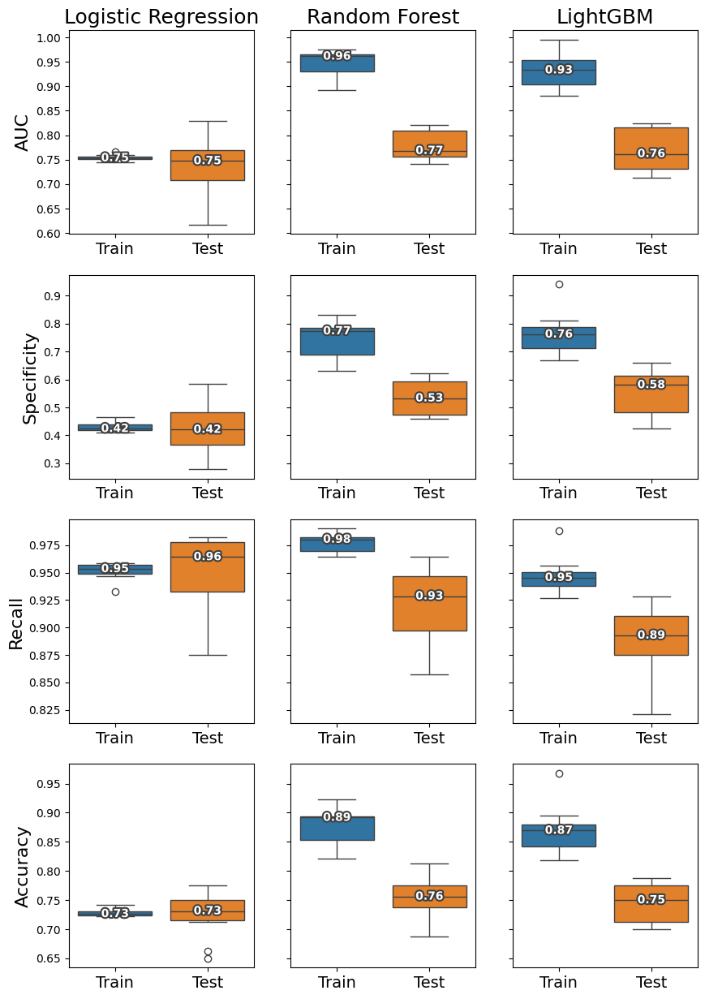

In [44]:
# Convert the scores to DataFrames
lr_scores = pd.DataFrame(lr_scores)
rf_scores = pd.DataFrame(rf_scores)
lgbm_scores = pd.DataFrame(lgbm_scores)

# Plot the train and test results by metric for the models. Share y-axis by metric
f, axs = plt.subplots(4, 3, figsize=(10, 15), sharey='row')

for i, name in enumerate(["AUC", "Specificity", "Recall", "Accuracy"]):
    # Logistic regression
    sns.boxplot(data=get_results(lr_scores, name), ax=axs[i][0])
    if i == 0: axs[i][0].set_title("Logistic Regression", size=18)
    axs[i][0].set_ylabel(name, size=16)
    axs[i][0].set_xticks([0, 1], ['Train', 'Test'], size=14)
    add_median_labels(axs[i][0])

    # Random Forest
    sns.boxplot(data=get_results(rf_scores, name), ax=axs[i][1])
    if i == 0: axs[i][1].set_title("Random Forest", size=18)
    axs[i][1].set_xticks([0, 1], ['Train', 'Test'], size=14)
    add_median_labels(axs[i][1])

    # LightGBM
    sns.boxplot(data=get_results(lgbm_scores, name), ax=axs[i][2])
    if i == 0: axs[i][2].set_title("LightGBM", size=18)
    axs[i][2].set_xticks([0, 1], ['Train', 'Test'], size=14)
    add_median_labels(axs[i][2]);

We conclude that all models achieve similar cross-validated AUC scores. However, LightGBM has higher specificity (57% vs. 54%) and accuracy (77% vs 74%) while being faster to train than the second best model Random Forest. The resulting model size is also around 5 times smaller. The only disadvantage is its lower Recall relative Logistic Regression.

The financial industry might additionally value not giving loans to someone with bad credit risk more than they do giving a loan to someone with good credit risk. Thus, higher specificity might be desired. Taking these things into account, we will move forward with the LightGBM model.

In [ ]:
# Re-Reading the csv file because changes masde in Class column
df = pd.read_csv('../datasets/raw/credit-g.csv')
df.rename(columns={'class': 'Class'}, inplace=True)
df.rename(columns=lambda x: x.strip(), inplace=True)

In [ ]:
# Define the preprocessing steps
preprocessing = make_column_transformer(
    (RobustScaler(), ["duration",
                      "credit_amount",
                      "installment_commitment",
                      "residence_since",
                      "age",
                      "existing_credits",
                      "num_dependents"]),  # Scaling
    
    (OneHotEncoder(), ["checking_status",
                       "credit_history",
                       "purpose",
                       "savings_status",
                       "employment",
                       "personal_status",
                       "other_parties",
                       "property_magnitude",
                       "other_payment_plans",
                       "housing",
                       "job",
                       "own_telephone",
                       "foreign_worker"]),  # One-hot encoding
)

In [ ]:
logistic_param_grid = {
    'penalty': ['l2'],
    'C': [0.1, 1, 10]
}

rf_param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10]
}

svm_param_grid = {
    'kernel': ['linear', 'rbf']
}

In [ ]:
# Define the classifiers
classifiers = [
    ('logistic', LogisticRegression()),
    ('random_forest', RandomForestClassifier()),
    ('svm', SVC(probability=True))
]

# Create the pipeline
pipeline = Pipeline([
    ('preprocessing', preprocessing),
    ('classifier', GridSearchCV(
        estimator=LogisticRegression(),  # Default estimator, will be changed during grid search
        param_grid=logistic_param_grid,
        cv=StratifiedKFold(3),
        verbose=2,
        n_jobs=8
    ))
])


In [ ]:
X = df.drop(columns=['Class'])
y = df.Class

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

X_train_preprocessed = pipeline.named_steps['preprocessing'].fit_transform(X_train)
X_test_preprocessed = pipeline.named_steps['preprocessing'].fit_transform(X_test)

In [ ]:
# Perform grid search and evaluation for each classifier
for name, classifier in classifiers:
    
    pipeline.named_steps['classifier'].estimator = classifier
    
    if name == 'logistic':
        pipeline.named_steps['classifier'].param_grid = logistic_param_grid
    elif name == 'random_forest':
        pipeline.named_steps['classifier'].param_grid = rf_param_grid
    elif name == 'svm':
        pipeline.named_steps['classifier'].param_grid = svm_param_grid
        
    pipeline.named_steps['classifier'].fit(X_train_preprocessed, y_train)
    y_pred = pipeline.named_steps['classifier'].predict(X_test_preprocessed)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, pos_label='good')
    recall = recall_score(y_test, y_pred, pos_label='good')
    f1 = f1_score(y_test, y_pred, pos_label='good')
    # Print the best parameters, best score, and accuracy for each classifier
    print(f'Classifier: {name}')
    print('Best parameters:', pipeline.named_steps['classifier'].best_params_)
    print('Best score:', pipeline.named_steps['classifier'].best_score_)
    print('Accuracy:', accuracy)
    print('Precision:', precision)
    print('Recall:', recall)
    print('F1-score:', f1)
    
    cm = confusion_matrix(y_test, y_pred)

    # Plot the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='d', square=True)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()
    
    print('---')